In [7]:
import numpy as np
import sympy as sp
from scipy.integrate import odeint
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

In [8]:
t = sp.Symbol('t')
m1, m2, l1, l2, g = sp.symbols('m1, m2, l1, l2, g', positive=True)
theta1 = sp.Function('theta1')(t)
theta2 = sp.Function('theta2')(t)
d_theta1 = theta1.diff(t)
d_theta2 = theta2.diff(t)
dd_theta1 = d_theta1.diff(t)
dd_theta2 = d_theta2.diff(t)

x1 = l1 * sp.sin(theta1)
y1 = -l1 * sp.cos(theta1)
x2 = x1 + l2 * sp.sin(theta2)
y2 = y1 - l2 * sp.cos(theta2)

dx1 = x1.diff(t)
dy1 = y1.diff(t)
dx2 = x2.diff(t)
dy2 = y2.diff(t)

T1 = 0.5 * m1 * (dx1**2 + dy1**2)
T2 = 0.5 * m2 * (dx2**2 + dy2**2)
T = T1 + T2

V = m1*g*y1 + m2*g*y2

L = T - V

eq1 = sp.diff(L.diff(d_theta1), t) - L.diff(theta1)
eq2 = sp.diff(L.diff(d_theta2), t) - L.diff(theta2)

sol = sp.solve([eq1, eq2], (dd_theta1, dd_theta2))
dd_theta1_sol = sol[dd_theta1]
dd_theta2_sol = sol[dd_theta2]

f_dd_theta1 = sp.lambdify((theta1, theta2, d_theta1, d_theta2, m1, m2, l1, l2, g), dd_theta1_sol, 'numpy')
f_dd_theta2 = sp.lambdify((theta1, theta2, d_theta1, d_theta2, m1, m2, l1, l2, g), dd_theta2_sol, 'numpy')

def equations(state, t, m1_val, m2_val, l1_val, l2_val, g_val):
    theta1, omega1, theta2, omega2 = state
    domega1 = f_dd_theta1(theta1, theta2, omega1, omega2, m1_val, m2_val, l1_val, l2_val, g_val)
    domega2 = f_dd_theta2(theta1, theta2, omega1, omega2, m1_val, m2_val, l1_val, l2_val, g_val)
    return [omega1, domega1, omega2, domega2]

Animation size has reached 20985272 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


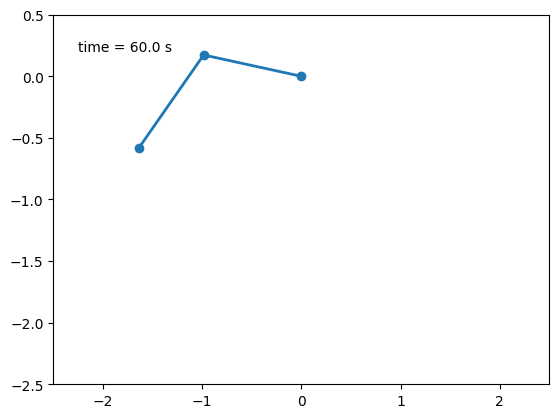

: 

: 

: 

In [9]:
m1_val, m2_val = 1.0, 1.0
l1_val, l2_val = 1.0, 1.0
g_val = 9.81

theta1_0, omega1_0 = np.pi / 2, -2.0
theta2_0, omega2_0 = np.pi / 2, -1.0
state0 = [theta1_0, omega1_0, theta2_0, omega2_0]

t = np.linspace(0, 60, 2000)

solution = odeint(equations, state0, t, args=(m1_val, m2_val, l1_val, l2_val, g_val))
theta1, omega1, theta2, omega2 = solution.T

x1 = l1_val * np.sin(theta1)
y1 = -l1_val * np.cos(theta1)
x2 = x1 + l2_val * np.sin(theta2)
y2 = y1 - l2_val * np.cos(theta2)

fig, ax = plt.subplots()
ax.set_xlim(-2.5, 2.5)
ax.set_ylim(-2.5, 0.5)
line, = ax.plot([], [], 'o-', lw=2)
time_text = ax.text(0.05, 0.9, '', transform=ax.transAxes)

def init():
    line.set_data([], [])
    time_text.set_text('')
    return line, time_text

frame_skip = 1
frames = range(0, len(t), frame_skip)

coords = [(x1[i], y1[i], x2[i], y2[i]) for i in frames]

def animate(i):
    x1_i, y1_i, x2_i, y2_i = coords[i]
    line.set_data([0, x1_i, x2_i], [0, y1_i, y2_i])
    time_text.set_text(f'time = {t[i*frame_skip]:.1f} s')
    return line, time_text

ani = FuncAnimation(fig, animate, frames=len(frames), init_func=init, blit=True, interval=10)
HTML(ani.to_jshtml())